## SQL Connect

In [37]:
#remove FutureWarnings
import warnings
warnings.filterwarnings('ignore')

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from IPython.display import Audio, display

def alldone():
    display(Audio(filename='Bossa Vega - Mike Figgis.mp3', autoplay=True))
    #display(Audio(filename='Notification Chime.wav', autoplay=True))

import os
    
from PIL import Image
import requests
from io import BytesIO

import pandas as pd
import numpy as np

import time
from lxml import html
import requests
from bs4 import BeautifulSoup

#set display image size
width = 188
height = 333

from ftplib import FTP, error_perm
ftp = FTP()
ftp.encoding = "UTF-8"

def connect_ftp():
    ftp.connect('172.96.191.12', 21) # Hawkhost
    ftp.login('admin@blacklistseller.com','!Internet1')
    ftp.cwd('/public_html/assets/uploads/user_uploads_report/')

connect_ftp()
    
import mysql.connector
from mysql.connector import Error

import numpy as np 
import pandas as pd
file = open("host.txt", 'r')
for line in file.readlines():
    data = line.rstrip().split(',') #using rstrip to remove the \n
    username = data[0]
    password = data[1]    
    

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()
    


In [9]:
# Find latest report id

#%%capture
file = open("last_report_id.txt", 'r')
for line in file.readlines():
    data = line.rstrip().split(',') #using rstrip to remove the \n    
print(f"Last report that display : {data}")

#Check latest report id
response = requests.get("https://www.blacklistseller.com")
soup = BeautifulSoup(response.text, 'html.parser')
#soup.findAll('a')

latest_report_id = str(soup.findAll('a')[7])
latest_report_id=latest_report_id.split("/")[5][0:5]
latest_report_id = int(latest_report_id)

text_file = open("last_report_id.txt", encoding="utf-8", mode="w")
text_file.write(str(latest_report_id) + "\n")
#text_file.write(SQL)
text_file.close()
print(f'Recent checked report : {latest_report_id}')

Last report that display : ['14899']


6

Recent checked report : 14901


## Load list of files

In [10]:
#List all files
start_time = time.time()
mycursor.execute("select * from tb_report_item")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
file = pd.DataFrame(result, columns=field_names)
print(round((time.time() - start_time),2), " second running time")

16.49  second running time


## Setting to override

In [11]:
#Start screening from below command

#Report that name code is still gencode is < 13400 

number_report_to_show = 40
#latest_report_id = 14771

In [12]:
#Search by report_id and group picture
start_time = time.time()
report_id_to_show =[]
report_id_to_show = list(range(latest_report_id-number_report_to_show+1,latest_report_id+1))
report_id_to_show = [str(x).zfill(len(str(number_report_to_show))) for x in report_id_to_show]


#selected = file[(file['report_id'].isin(report_id_to_show)) & (file['report_item_active'] == 1)]
selected = file[(file['report_id'].isin(report_id_to_show))]

print("Total pictures = " + str(selected.shape[0]))

#Prepare group list
recent_pic = selected['report_item_filename'].values.tolist()
#create variable "group" : a list that group pic for each report_id
temp=[]
group = []
k=0

for x in report_id_to_show:
    for j in range(len(recent_pic)):        
        if recent_pic[j][1:6] == str(x):
            temp.append(recent_pic[j])
        #group[k]= temp
    try:
        group.append(temp)
    except IndexError:
        print("some error")
    
    temp=[]
    k+=1
    

Total pictures = 544


## Display report pictures

'14862'

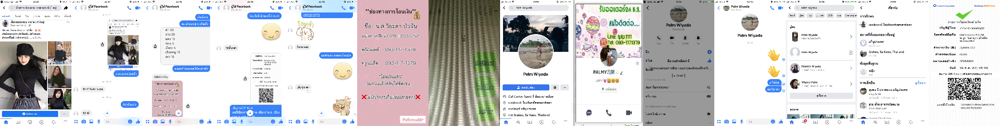

'14863'

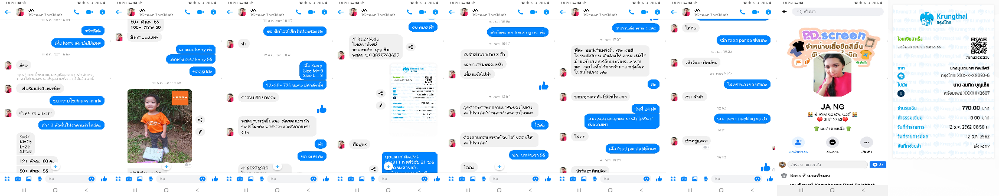

'14864'

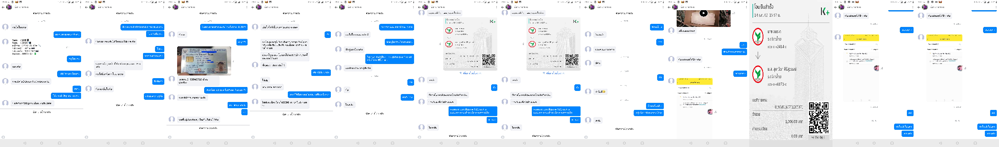

'14865'

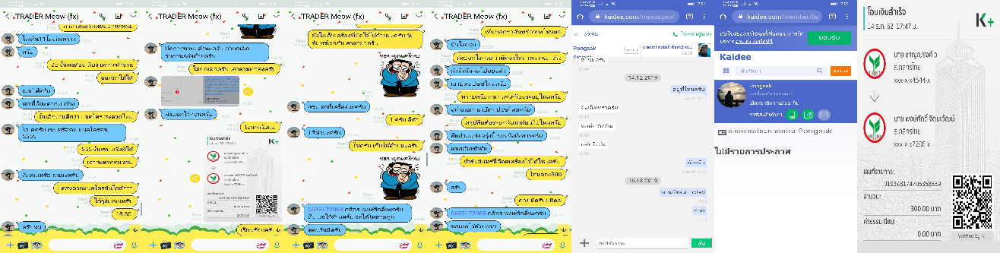

'14866'

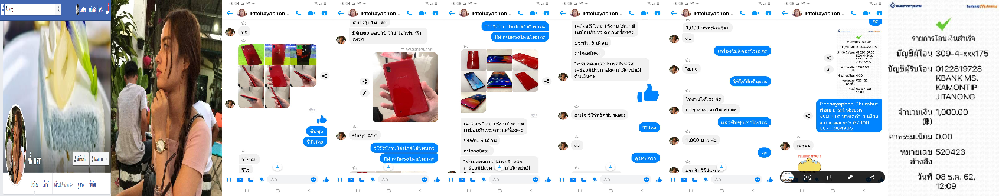

'14867'

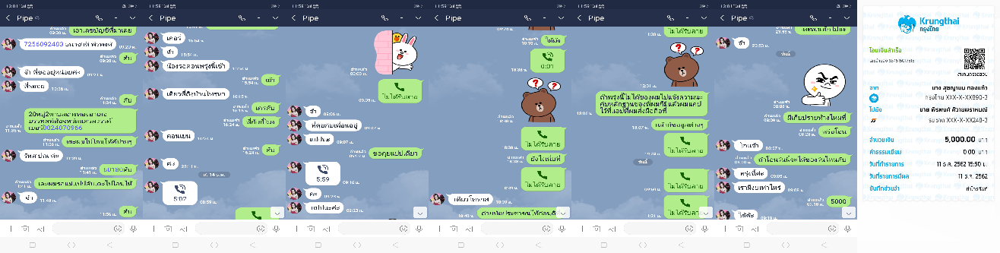

'14868'

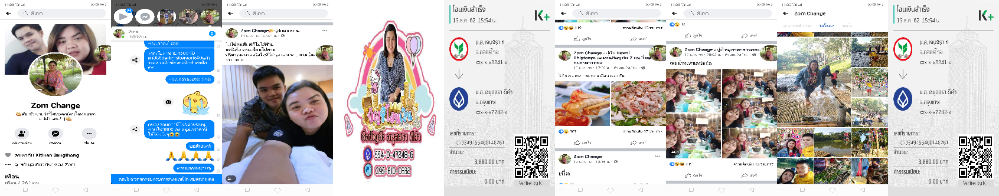

'14869'

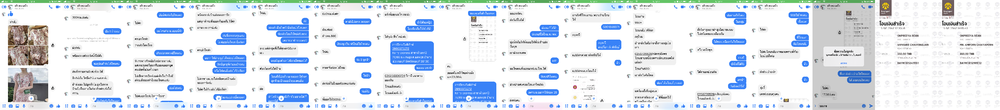

'14870'

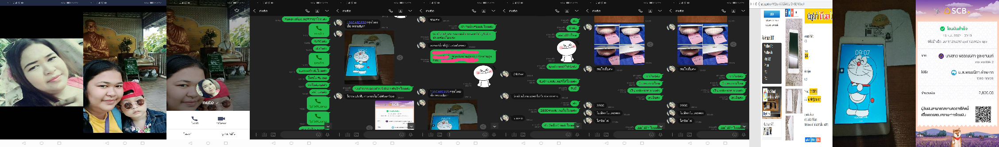

'14871'

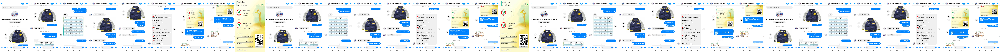

'14872'

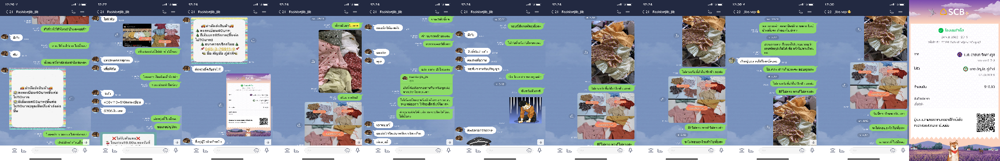

'14873'

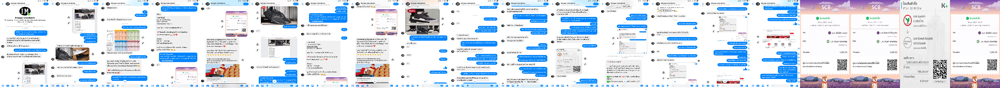

'14874'

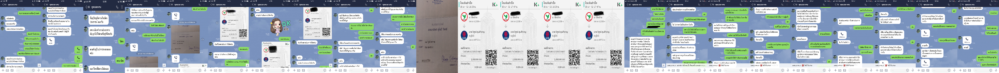

'14875'

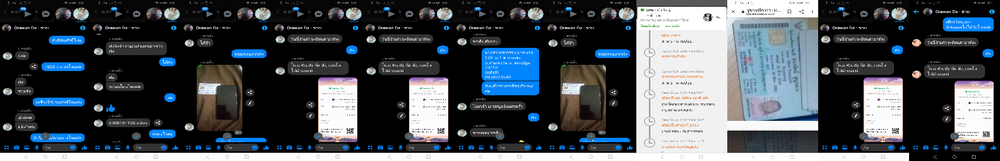

'14876'

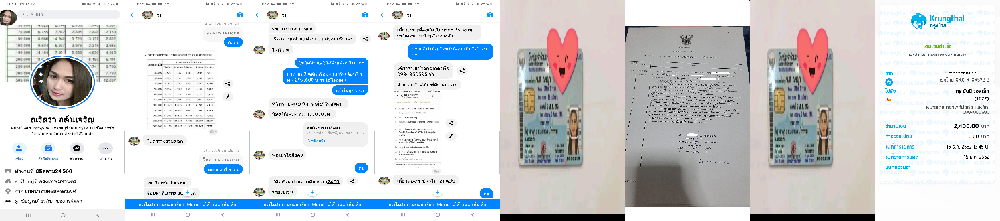

'14877'

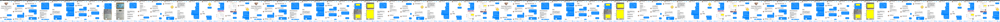

'14878'

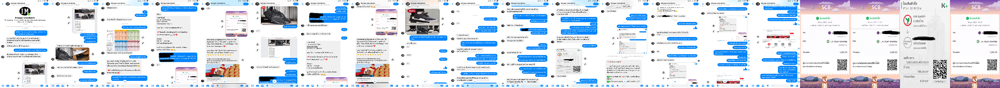

'14879'

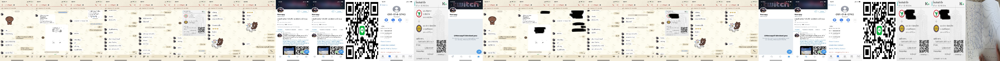

'14880'

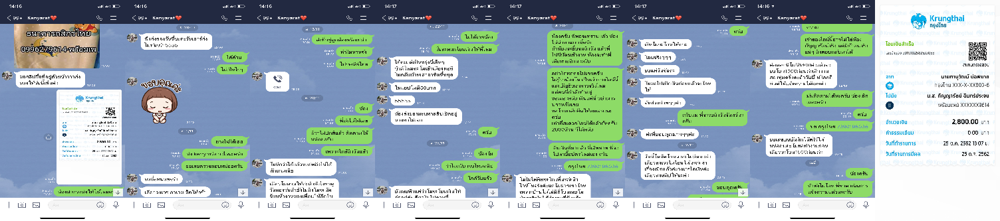

'14881'

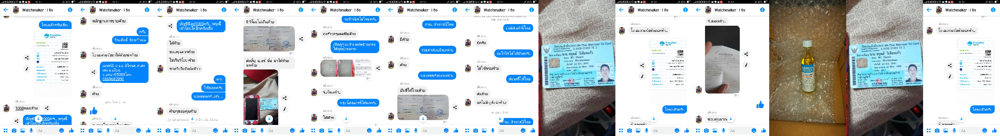

'14882'

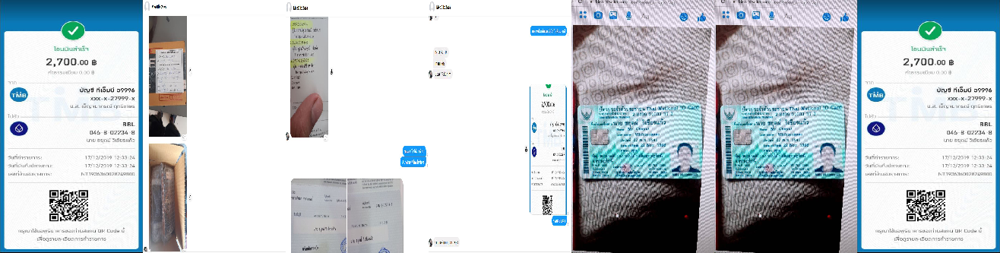

'14883'

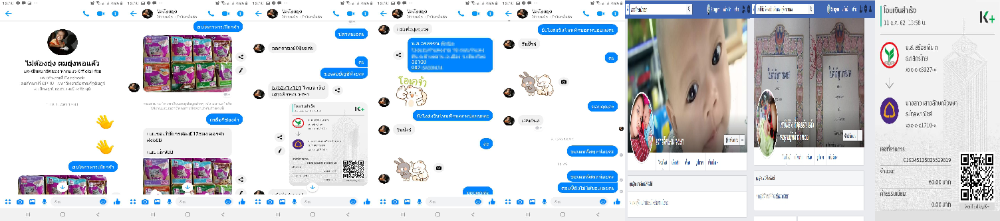

'14884'

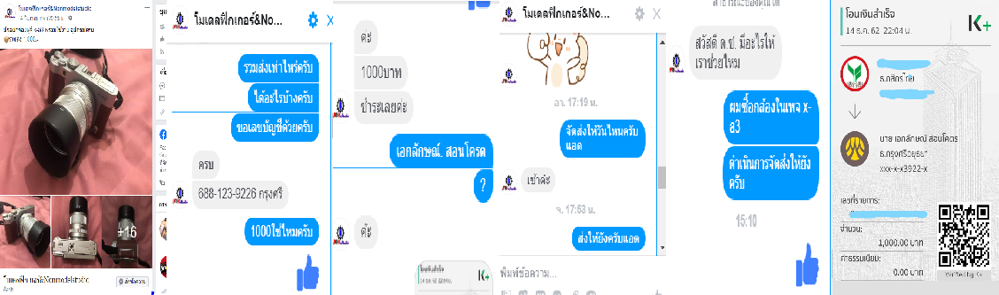

'14885'

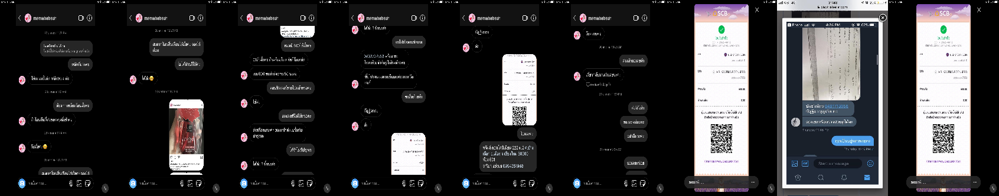

'14886'

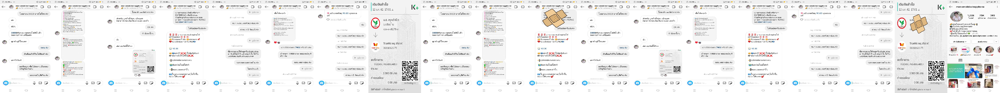

'14887'

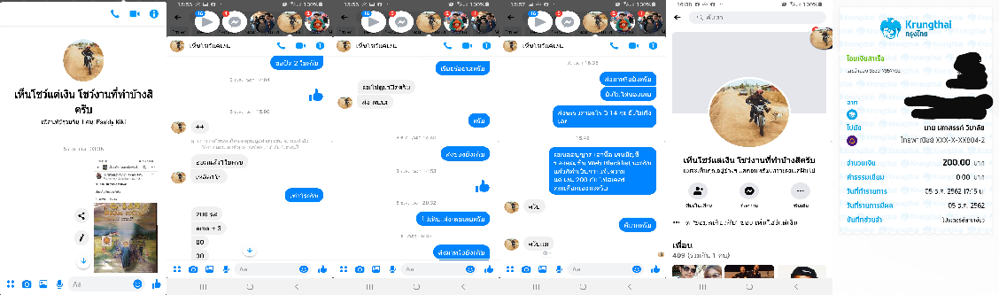

'14888'

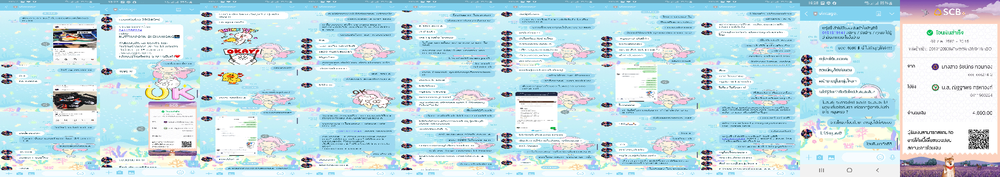

'14889'

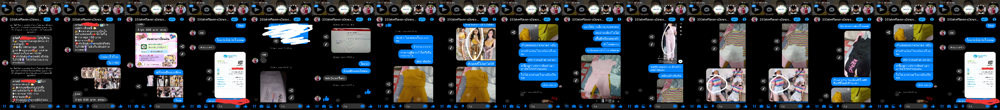

'14890'

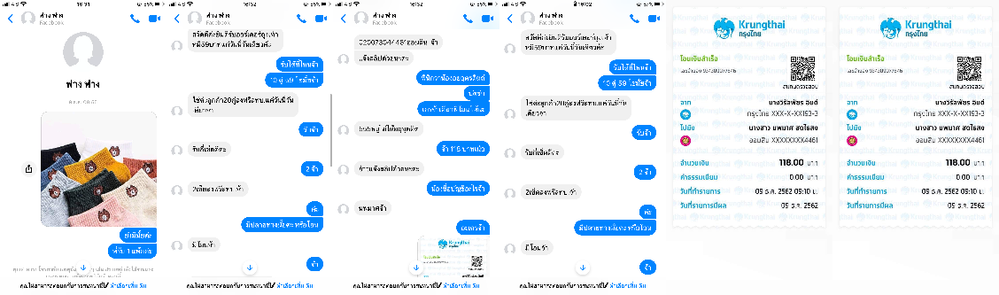

'14891'

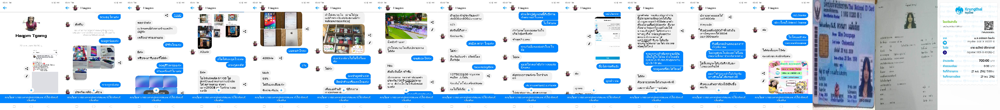

'14892'

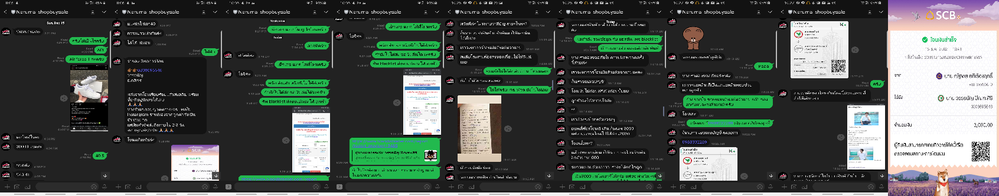

'14893'

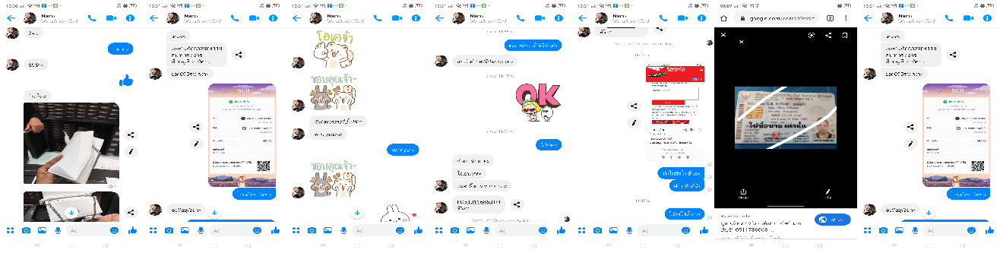

'14894'

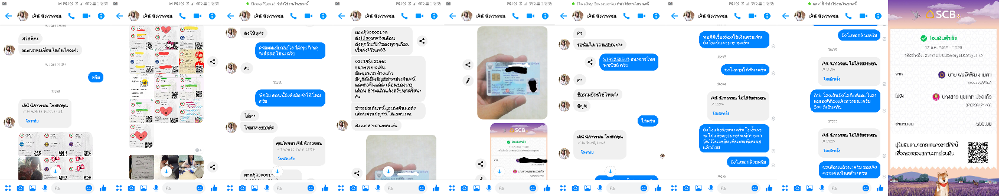

'14895'

Could not opened
Could not opened


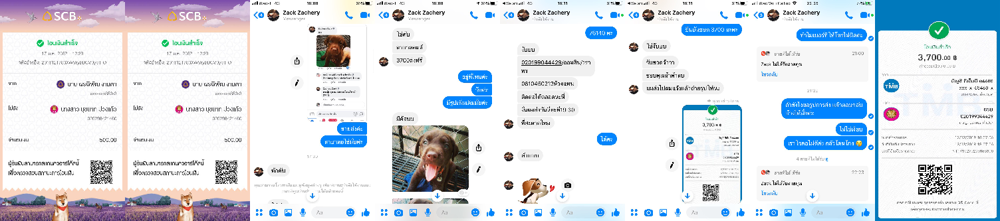

'14896'

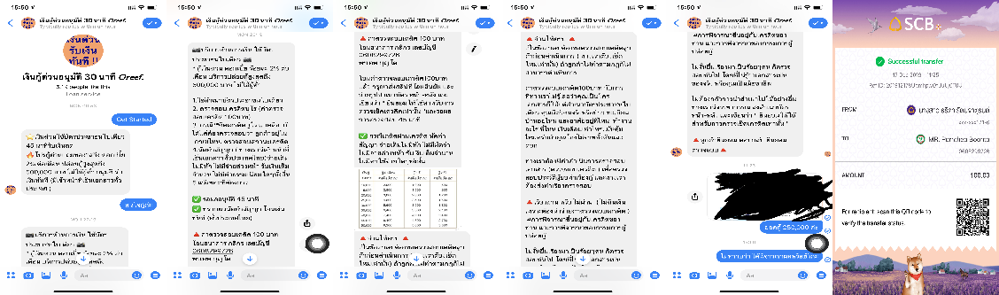

'14897'

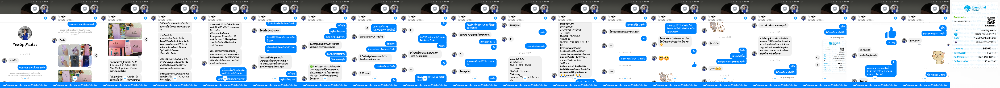

'14898'

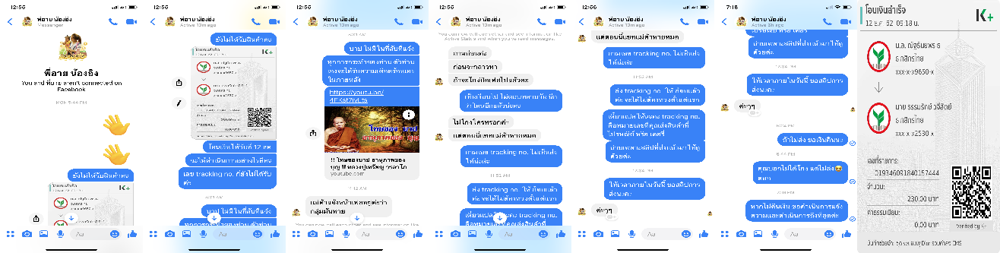

'14899'

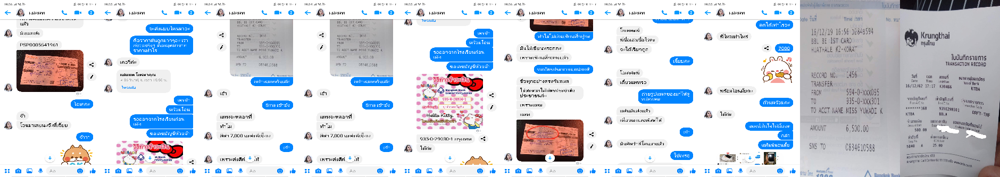

'14900'

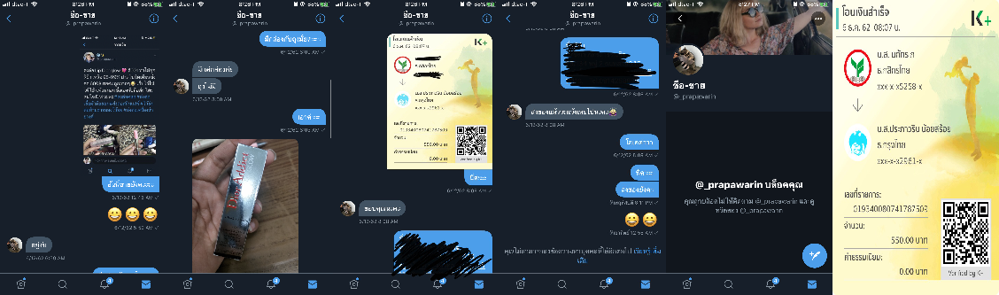

'14901'

Could not opened
Could not opened
Could not opened
Could not opened
Could not opened


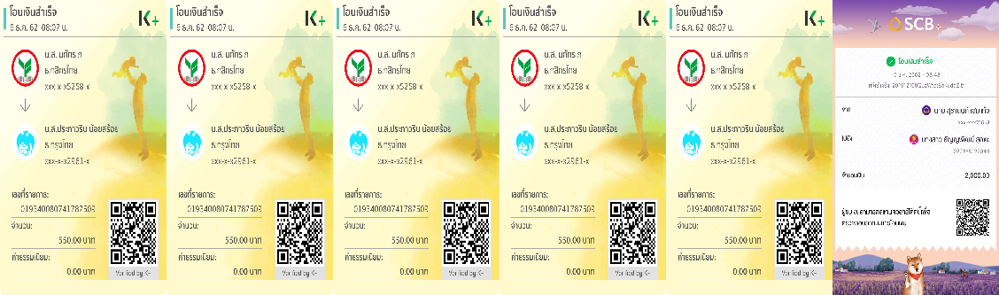

7.51  minutes running time


In [13]:
#Display report pictures
start_time = time.time()

test=[]
for x in group:
    z=0
    test=[]
    for y in range(len(x)):        
        url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x[z]
        test.append(url)
        z+=1
        
    if x != []:
        x[z-1][1:6]

        x_offset = 0
        new_im = Image.new('RGB', (width*len(x),height))
        for x in test:
            response = requests.get(x)

            #img = Image.open(BytesIO(response.content))
            #img = img.resize( (width , height), resample=0)
            try:
                img = Image.open(BytesIO(response.content))
            except IOError:
                #print '%s could not be opened' % imagepath
                print("Could not opened")

            img = img.resize( (width , height), resample=0)

            new_im.paste(img, (x_offset,0))
            x_offset += width
        new_im

alldone()        
print(round((time.time() - start_time)/60,2), " minutes running time")

# ============END==============

### Find user who create by report id

In [7]:
x = 12949 # report id to find

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.report_id = " + str(x)
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)


,report_id,user_id,username,facebook_id,first_name,last_name,email,phone_number,first_name,last_name
0,12949,35213,,1294853127360951,Chorthip,Thisomboon,0,,แอบอ้างชื่อคนอื่น,แอบอ้างชื่อคนอื่น


### Find user who create by lastname

In [46]:
x = 'ภูมิสุข'  # report id to find

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

TEXT = "SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.last_name LIKE '" + x +"'"
TEXT
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)


"SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.last_name LIKE 'ภูมิสุข'"

,report_id,user_id,username,facebook_id,first_name,last_name,email,phone_number,first_name,last_name
0,10505,14447,Siranan,,สิทธิกร,สินศิริ,siranan26956@gmail.com,0994962455,กิจณี,ภูมิสุข
1,11607,32657,,1313968305450940,James,Annison,0,,กิจณี,ภูมิสุข


### Find most freq name recently

In [ ]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()


TEXT = "SELECT count(*),first_name,last_name FROM tb_report where report_id IN (SELECT report_id FROM `tb_report` WHERE create_date >= (CURRENT_TIMESTAMP()-60*60*24*2)) GROUP by last_name order by count(*) DESC limit 10"
TEXT
mycursor.execute(TEXT)
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]
pd.DataFrame(result, columns=field_names)

## To display specific report picture

'มลิษา ชนะรัตน์'

Number of picture: 6


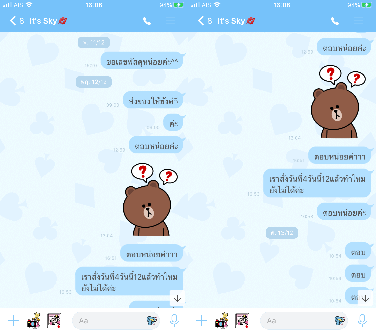

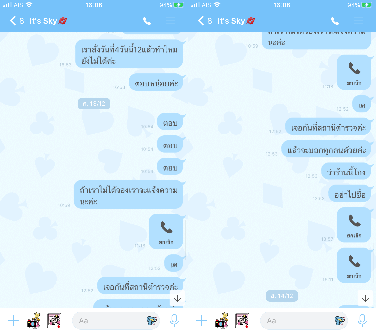

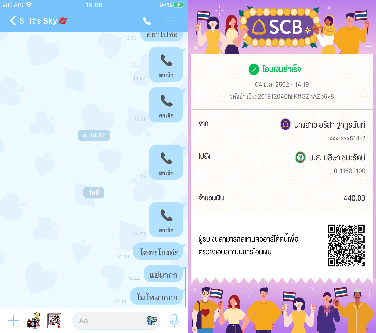

In [35]:
to_display = 14817  

#display name
response = requests.get("https://www.blacklistseller.com/report/report_preview/" + str(to_display))
soup = BeautifulSoup(response.text, 'html.parser')
linetoscreen = str(soup.findAll('a')[5])
name = linetoscreen.split("</a>")[0].split('>')[1]
name

list_of_report = file[(file['report_id'] == to_display) & (file['report_item_active'] == 1)]['report_item_filename'].values.tolist()
print(f'Number of picture: {len(list_of_report)}')
link=[]
for x in list_of_report:
    url = "https://www.blacklistseller.com/assets/uploads/user_uploads_report/" + x
    link.append(url)

split_by = round(len(link)/3)
link1 = link[0:split_by]
link2 = link[split_by:split_by*2]
link3 = link[split_by*2:]
sum_link = []
sum_link.append(link1)
sum_link.append(link2)
sum_link.append(link3)

for y in sum_link:    
    x_offset = 0
    new_im = Image.new('RGB', (width*len(y),height))
    for x in y:
        response = requests.get(x)

        #img = Image.open(BytesIO(response.content))
        #img = img.resize( (width , height), resample=0)
        try:
            img = Image.open(BytesIO(response.content))
        except IOError:
            #print '%s could not be opened' % imagepath
            print("Could not opened")

        img = img.resize( (width , height), resample=0)

        new_im.paste(img, (x_offset,0))
        x_offset += width
    new_im        
    


# DELETE REPORT : Code to delete reports (picture and db)

In [14]:
# Connect to FTP & SQL
# %%capture  error using this command

from ftplib import FTP, error_perm
ftp = FTP()
ftp.encoding = "UTF-8"

connect_ftp()

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

# ftp.connect('172.96.191.12', 21) # Hawkhost
# ftp.login('admin@blacklistseller.com','!Internet1')
# ftp.cwd('/public_html/assets/uploads/user_uploads_report/')

# connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
# mycursor = connection.cursor()

In [15]:
to_delete = ""
to_delete = input()
to_delete = to_delete.split()
print("ลบด้วยเหตุผลพิเศษ?")
reason = ""
reason = input()
print("List of report_id to delete " + str(to_delete))
print("\n")

df_prepare_to_del = file[(file['report_id'].isin(to_delete))]
file_to_del = df_prepare_to_del['report_item_filename'].values.tolist()
    
#delete files    
for x in file_to_del:    
    print("ftp.delete('" + x + "')")            
    try:
        ftp.delete(x)
    except error_perm:
        print("!!  file already deleted")
    
SQL = "" #SQL code to delete report
for x in to_delete:
    TEXT = "UPDATE tb_report SET active = 0 WHERE tb_report.report_id = " + str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()
    
    #Add detail text
    if reason == "":
        TEXT = "UPDATE tb_report SET detail_text = CONCAT(' !รายงานถูกลบเนื่องจากรายละเอียดไม่เพียงพอ! | ', detail_text) WHERE `tb_report`.`report_id` = " + str(x) +";"
        TEXT
        mycursor.execute(TEXT)
        connection.commit()
    else:
        TEXT = "UPDATE tb_report SET detail_text = CONCAT(' "+ str(reason)+ " | ', detail_text) WHERE `tb_report`.`report_id` = " + str(x) +";"
        TEXT
        mycursor.execute(TEXT)
        connection.commit()            
    
    #Delete db record
    TEXT = "DELETE FROM tb_report_item WHERE tb_report_item.report_id = " + str(x)
    TEXT
    mycursor.execute(TEXT)
    connection.commit()

14868 14882
ลบด้วยเหตุผลพิเศษ?

List of report_id to delete ['14868', '14882']


ftp.delete('[14868]_Screenshot_2019-12-17-11-29-56-95.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-29-56-95.png'

ftp.delete('[14868]_Screenshot_2019-12-17-11-28-45-47.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-28-45-47.png'

ftp.delete('[14868]_Screenshot_2019-12-17-11-30-11-24.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-30-11-24.png'

ftp.delete('[14868]_received_2551335845191221.jpeg')


'250 Deleted [14868]_received_2551335845191221.jpeg'

ftp.delete('[14868]_received_2622152267834402.jpeg')


'250 Deleted [14868]_received_2622152267834402.jpeg'

ftp.delete('[14868]_Screenshot_2019-12-17-11-30-06-96.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-30-06-96.png'

ftp.delete('[14868]_Screenshot_2019-12-17-11-30-02-54.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-30-02-54.png'

ftp.delete('[14868]_Screenshot_2019-12-17-11-35-52-69.png')


'250 Deleted [14868]_Screenshot_2019-12-17-11-35-52-69.png'

ftp.delete('[14868]_019349155400146261.jpeg')


'250 Deleted [14868]_019349155400146261.jpeg'

ftp.delete('[14882]_1.JPG')


'250 Deleted [14882]_1.JPG'

ftp.delete('[14882]_2.JPG')


'250 Deleted [14882]_2.JPG'

ftp.delete('[14882]_3.JPG')


'250 Deleted [14882]_3.JPG'

ftp.delete('[14882]_4.JPG')


'250 Deleted [14882]_4.JPG'

ftp.delete('[14882]_5.jpg')


'250 Deleted [14882]_5.jpg'

ftp.delete('[14882]_5.jpg')
!!  file already deleted
ftp.delete('[14882]_1.JPG')
!!  file already deleted


'UPDATE tb_report SET active = 0 WHERE tb_report.report_id = 14868'

"UPDATE tb_report SET detail_text = CONCAT(' !รายงานถูกลบเนื่องจากรายละเอียดไม่เพียงพอ! | ', detail_text) WHERE `tb_report`.`report_id` = 14868;"

'DELETE FROM tb_report_item WHERE tb_report_item.report_id = 14868'

'UPDATE tb_report SET active = 0 WHERE tb_report.report_id = 14882'

"UPDATE tb_report SET detail_text = CONCAT(' !รายงานถูกลบเนื่องจากรายละเอียดไม่เพียงพอ! | ', detail_text) WHERE `tb_report`.`report_id` = 14882;"

'DELETE FROM tb_report_item WHERE tb_report_item.report_id = 14882'

## To DELETE specific pic by filename

In [6]:
#Delete specific file name

connect_ftp()

connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

to_delete = "[14724]_EFE24F4E-7341-4492-B2D0-C78563EBB1EF.jpeg"
#to_delete = input()


try:
    ftp.delete(to_delete)
except error_perm:
    print("!!  file already deleted")
    
TEXT = "DELETE FROM tb_report_item WHERE tb_report_item.report_item_filename = '" + to_delete +"'"
TEXT
mycursor.execute(TEXT)
connection.commit()

'250 Deleted [14724]_EFE24F4E-7341-4492-B2D0-C78563EBB1EF.jpeg'

"DELETE FROM tb_report_item WHERE tb_report_item.report_item_filename = '[14724]_EFE24F4E-7341-4492-B2D0-C78563EBB1EF.jpeg'"

In [ ]:
#execute SQL Command sample

mycursor.execute("SELECT tb_report.report_id, tb_user.user_id, tb_user.username, tb_user.facebook_id, tb_user.first_name, tb_user.last_name, tb_user.email, tb_user.phone_number, tb_report.first_name, tb_report.last_name FROM tb_report JOIN tb_user ON tb_report.user_id = tb_user.user_id WHERE tb_report.report_id LIKE 1111")
result = mycursor.fetchall()

#Get column name
field_names = [i[0] for i in mycursor.description]

# for x in result:
#   print(x)

pd.DataFrame(result, columns=field_names)

## Clean tb_report

In [17]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

mycursor.execute("select * from tb_report")
result = mycursor.fetchall()
field_names = [i[0] for i in mycursor.description]  #Column name
tb_report = pd.DataFrame(result, columns=field_names)

In [18]:
df = tb_report[['report_id','first_name','last_name','idcard']]
df['fullname'] = df['first_name']+ " " + df['last_name']

## Use Fuzzzywuzzy to detect wrong name

In [21]:
from fuzzywuzzy import fuzz
df_master=df['fullname'].value_counts().head(800)
df_master.tail()

อลิสา โพธิ์ทอง       3
วิชุดา เสนะกุล       3
ธาริณี ดีประเสริฐ    3
ชนิกานต์ จงพิมาย     3
เอมิกา น้อยหาด       3
Name: fullname, dtype: int64

In [22]:
df_master = pd.DataFrame(df_master)
df_master.rename({'fullname':'count'}, inplace=True )
df_master['fullname'] = df_master.index
df_master.reset_index(level=0, inplace=True)
df_master.drop('index', axis=1, inplace = True)

In [23]:
df_to_clean = df[~df.fullname.isin(df_master.fullname)]
df_to_clean.shape

(5592, 5)

## Start using Fuzzy

In [24]:
#df[df['fullname'].str.match(x)]
i=1
SQL = ""
for index, row in df_to_clean.iterrows():
    for y in df_master['fullname']:
        score = fuzz.ratio(row['fullname'],y)
        if ( score > 90) and ( score != 100):
            name = y.split()
            TEXT = "UPDATE tb_report SET first_name ='"+name[0]+"',"+"last_name = '"+name[1]+"'"+" WHERE tb_report.report_id = "+str(row['report_id'])+";#"
            TEXT
            SQL=SQL+TEXT
            print(i, "Report ID :", row['report_id'],"| Score:",score,"  \nผิด --> ",row['fullname'],"  \nถูก --> ",y,"\n")
            
alldone()

"UPDATE tb_report SET first_name ='น้ำฝน',last_name = 'ถมยาปริวัฒน์' WHERE tb_report.report_id = 13789;#"

1 Report ID : 13789 | Score: 97   
ผิด -->  น้ำฝน ถมยาปรวัฒน์   
ถูก -->  น้ำฝน ถมยาปริวัฒน์ 



"UPDATE tb_report SET first_name ='วรรณธนา',last_name = 'กระสีเสม' WHERE tb_report.report_id = 14757;#"

1 Report ID : 14757 | Score: 97   
ผิด -->  วรรธนา กระสีเสม   
ถูก -->  วรรณธนา กระสีเสม 



"UPDATE tb_report SET first_name ='อุไรวรรณ',last_name = 'ขวัญนาค' WHERE tb_report.report_id = 14764;#"

1 Report ID : 14764 | Score: 97   
ผิด -->  อุไรวรรณ​ ขวัญนาค   
ถูก -->  อุไรวรรณ ขวัญนาค 



"UPDATE tb_report SET first_name ='นภาลัย',last_name = 'แสงบุญ' WHERE tb_report.report_id = 14769;#"

1 Report ID : 14769 | Score: 96   
ผิด -->  นภาลัย แสงบุญ​   
ถูก -->  นภาลัย แสงบุญ 



"UPDATE tb_report SET first_name ='สุพัตรา',last_name = 'หงษาโด่' WHERE tb_report.report_id = 14776;#"

1 Report ID : 14776 | Score: 93   
ผิด -->  สุพัตรา หงสาโด่   
ถูก -->  สุพัตรา หงษาโด่ 



"UPDATE tb_report SET first_name ='บจก.กิจอัศวิน',last_name = 'บจก.กิจอัศวิน' WHERE tb_report.report_id = 14802;#"

1 Report ID : 14802 | Score: 96   
ผิด -->  บจก. กิจอัศวิน บจก. กิจอัศวิน   
ถูก -->  บจก.กิจอัศวิน บจก.กิจอัศวิน 



"UPDATE tb_report SET first_name ='วริษรา',last_name = 'ฮกเหลี่ยม' WHERE tb_report.report_id = 14823;#"

1 Report ID : 14823 | Score: 94   
ผิด -->  วริศรา ฮกเหลี่ยม   
ถูก -->  วริษรา ฮกเหลี่ยม 



"UPDATE tb_report SET first_name ='พีรพงศ์',last_name = 'ศิวายพราหมณ์' WHERE tb_report.report_id = 14867;#"

1 Report ID : 14867 | Score: 95   
ผิด -->  พีรพงษ์ ศิวายพราหมณ์   
ถูก -->  พีรพงศ์ ศิวายพราหมณ์ 



"UPDATE tb_report SET first_name ='นริศรา',last_name = 'มณีรัตน์' WHERE tb_report.report_id = 14902;#"

1 Report ID : 14902 | Score: 91   
ผิด -->  นส.นริศรา มณีรัตน์   
ถูก -->  นริศรา มณีรัตน์ 



### Execute SQL command to fix wrong name

In [26]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

SQL_list = SQL.split('#')
#SQL_list
for x in SQL_list:
    x
    mycursor.execute(x)
    connection.commit()    

"UPDATE tb_report SET first_name ='น้ำฝน',last_name = 'ถมยาปริวัฒน์' WHERE tb_report.report_id = 13789;"

"UPDATE tb_report SET first_name ='วรรณธนา',last_name = 'กระสีเสม' WHERE tb_report.report_id = 14757;"

"UPDATE tb_report SET first_name ='อุไรวรรณ',last_name = 'ขวัญนาค' WHERE tb_report.report_id = 14764;"

"UPDATE tb_report SET first_name ='นภาลัย',last_name = 'แสงบุญ' WHERE tb_report.report_id = 14769;"

"UPDATE tb_report SET first_name ='สุพัตรา',last_name = 'หงษาโด่' WHERE tb_report.report_id = 14776;"

"UPDATE tb_report SET first_name ='บจก.กิจอัศวิน',last_name = 'บจก.กิจอัศวิน' WHERE tb_report.report_id = 14802;"

"UPDATE tb_report SET first_name ='วริษรา',last_name = 'ฮกเหลี่ยม' WHERE tb_report.report_id = 14823;"

"UPDATE tb_report SET first_name ='พีรพงศ์',last_name = 'ศิวายพราหมณ์' WHERE tb_report.report_id = 14867;"

"UPDATE tb_report SET first_name ='นริศรา',last_name = 'มณีรัตน์' WHERE tb_report.report_id = 14902;"

''

## Filling missing idcard

In [63]:
df_master=df['idcard'].value_counts().head(300)
df_master.tail()
print("Total unique in master file =",len(df_master))
df_master = pd.DataFrame(df_master,index=None)
df_master.columns

3401200204221    2
1100702170485    2
1100200714438    2
1103702206253    2
1949900207149    2
Name: idcard, dtype: int64

Total unique in master file = 300


Index(['idcard'], dtype='object')

In [64]:
df_master['idcard1'] = df_master.index
df_master['count'] = df_master['idcard']
df_master.drop('idcard', axis=1, inplace = True)
df_master.reset_index(level=0, inplace=True)
df_master.drop('index', axis=1, inplace = True)
df_master.rename(columns={'idcard1':'idcard'}, inplace=True )
df_master = pd.merge(df_master, df, left_on='idcard', right_on='idcard', how = 'left')
df_master = df_master[['idcard','count','fullname']]
df_master.drop_duplicates(subset ="idcard", keep = 'first', inplace = True) 

df_master=df_master.drop(df_master.index[0])  #drop null idcard in master file
df_master.head()

,idcard,count,fullname
7941,1100201032560,305,มัญลิกา มีเอียด
8246,5341600023299,254,นภาลัย แสงบุญ
8500,1100700846058,52,อณาริน จำนงบุญ
8552,1100400651642,51,สุพรรษา นามตาน
8603,1200500063351,47,ก่อการ พรหมเต็ม


In [65]:
class color:
    purple = '\033[95m'
    cyan = '\033[96m'
    darkcyan = '\033[36m'
    blue = '\033[94m'
    green = '\033[92m'
    yellow = '\033[93m'
    red = '\033[91m'
    bold = '\033[1m'
    underline = '\033[4m'
    end = '\033[0m'

def checkPID(pid):
  if(len(pid) != 13):
    return False
  num=0 
  num2=13
  listdata=list(pid) 
  sum=0 
  while num<12:
    sum+=int(listdata[num])*(num2-num) 
    num+=1 
  digit13 = sum%11
  if digit13==0: 
    digit13=1 
  elif digit13==1:
    digit13=0
  else:
    digit13=11-digit13 
  if digit13==int(listdata[12]):
    return True
  else:
    return False


print(color.bold + "Check incorrect idcard from master db\n"+color.end)

# for x in df_master.idcard:
#     if checkPID(x) == False:
#         x
    
for index, row in df_master.iterrows():
    if checkPID(row.idcard) == False:
        print(f'Report id:{index} | National id: {row.idcard} | Name: {row.fullname}')        
print(color.cyan + 'Finished !' + color.end)


Check incorrect idcard from master db

Report id:9384 | National id: 1509901305379 | Name: ภาทวิดา ชมภูละม้าย
Report id:9836 | National id: 1420000057725 | Name: ศิริรัตน์ วงศ์ผาบุตร
Report id:10079 | National id: 511020003136 | Name: อัญชลี สัมพันธมิตร
Report id:10459 | National id: 1101500453644 | Name: ปัญชญา สุทธากุล
Finished !


In [66]:
df_master.head()

,idcard,count,fullname
7941,1100201032560,305,มัญลิกา มีเอียด
8246,5341600023299,254,นภาลัย แสงบุญ
8500,1100700846058,52,อณาริน จำนงบุญ
8552,1100400651642,51,สุพรรษา นามตาน
8603,1200500063351,47,ก่อการ พรหมเต็ม


In [67]:
df_to_clean = df[~df['idcard'].isin(df_master['idcard'])]
#df_to_clean['id_card'].sort_values().head(100)
print(f'Total in df: {df.shape[0]}')
print(f'Total in master file: {df_master.shape[0]}')
print(f'Total in df_to_clean: {df_to_clean.shape[0]}')
df_to_clean.drop('idcard', axis=1, inplace = True)

Total in df: 11579
Total in master file: 299
Total in df_to_clean: 8981


In [68]:
df_to_clean.head(1)
df_master.head(1)

,report_id,first_name,last_name,fullname
0,1,เวส,คงยืน,เวส คงยืน


,idcard,count,fullname
7941,1100201032560,305,มัญลิกา มีเอียด


In [74]:
df_filled = pd.merge(df_to_clean, df_master,on='fullname', how='inner')
print(f'Total to be fixed: {df_filled.shape[0]}')
df_filled['idcard']=df_filled['idcard'].astype('uint64')
df_filled.sort_values('idcard').head()

Total to be fixed: 98


,report_id,first_name,last_name,fullname,idcard,count
56,13489,ชมพูนุท,นัดกระจ่าง,ชมพูนุท นัดกระจ่าง,1100200878741,16
55,13018,ชมพูนุท,นัดกระจ่าง,ชมพูนุท นัดกระจ่าง,1100200878741,16
57,14673,ชมพูนุท,นัดกระจ่าง,ชมพูนุท นัดกระจ่าง,1100200878741,16
70,14347,อัฑฒ์ฐนิตญ์,โพธิเลิศ,อัฑฒ์ฐนิตญ์ โพธิเลิศ,1100500326603,2
60,13526,มด,เลี้ยงรอด,มด เลี้ยงรอด,1101400529830,23


## Begin idcard matching

In [70]:
i=0
TEXT=""
SQL=""
for index, row in df_filled.iterrows():   
    TEXT = "UPDATE tb_report SET idcard = " + str(row['idcard']) + " WHERE tb_report.report_id = "+ str(row['report_id']) +";#"
    SQL+=str(TEXT)

In [73]:
SQL_list = SQL.split('#')
print(f'Number of report to fix idcard : {len(SQL_list)}')
SQL_list

Number of report to fix idcard : 99


['UPDATE tb_report SET idcard = 1749900429518 WHERE tb_report.report_id = 1725;',
 'UPDATE tb_report SET idcard = 1429900373124 WHERE tb_report.report_id = 3135;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3941;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3942;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3943;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3944;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4545;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4546;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4549;',
 'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4550;',
 'UPDATE tb_report SET idcard = 1669800142706 WHERE tb_report.report_id = 8030;',
 'UPDATE tb_report SET idcard = 1669800142706 WHERE tb_report.report_id = 11967;',
 'UPDATE tb_rep

### Execute command to fix id card

In [75]:
connection = mysql.connector.connect(host='172.96.191.12',database='blacklis_dbnew',user=username,password=password)
mycursor = connection.cursor()

for x in SQL_list:
    mycursor.execute(x)
    x
    connection.commit()    

'UPDATE tb_report SET idcard = 1749900429518 WHERE tb_report.report_id = 1725;'

'UPDATE tb_report SET idcard = 1429900373124 WHERE tb_report.report_id = 3135;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3941;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3942;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3943;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 3944;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4545;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4546;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4549;'

'UPDATE tb_report SET idcard = 4101500026672 WHERE tb_report.report_id = 4550;'

'UPDATE tb_report SET idcard = 1669800142706 WHERE tb_report.report_id = 8030;'

'UPDATE tb_report SET idcard = 1669800142706 WHERE tb_report.report_id = 11967;'

'UPDATE tb_report SET idcard = 2939900014608 WHERE tb_report.report_id = 9421;'

'UPDATE tb_report SET idcard = 2939900014608 WHERE tb_report.report_id = 11097;'

'UPDATE tb_report SET idcard = 2939900014608 WHERE tb_report.report_id = 14564;'

'UPDATE tb_report SET idcard = 1729900272694 WHERE tb_report.report_id = 9479;'

'UPDATE tb_report SET idcard = 1729900272694 WHERE tb_report.report_id = 13629;'

'UPDATE tb_report SET idcard = 1104300023856 WHERE tb_report.report_id = 11155;'

'UPDATE tb_report SET idcard = 3309900133449 WHERE tb_report.report_id = 11323;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 11996;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12092;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12114;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12130;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12149;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12196;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12398;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12411;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12419;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12420;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 12423;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14433;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14548;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14765;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14766;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14771;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14773;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14777;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14788;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14797;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14798;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14811;'

'UPDATE tb_report SET idcard = 5341600023299 WHERE tb_report.report_id = 14846;'

'UPDATE tb_report SET idcard = 1209601293074 WHERE tb_report.report_id = 12053;'

'UPDATE tb_report SET idcard = 1419901725415 WHERE tb_report.report_id = 12113;'

'UPDATE tb_report SET idcard = 1769900582995 WHERE tb_report.report_id = 12400;'

'UPDATE tb_report SET idcard = 1769900582995 WHERE tb_report.report_id = 14578;'

'UPDATE tb_report SET idcard = 1420000057725 WHERE tb_report.report_id = 12553;'

'UPDATE tb_report SET idcard = 1420000057725 WHERE tb_report.report_id = 14494;'

'UPDATE tb_report SET idcard = 1469900178097 WHERE tb_report.report_id = 12875;'

'UPDATE tb_report SET idcard = 1469900178097 WHERE tb_report.report_id = 14684;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 12993;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 14566;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 14784;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 14828;'

'UPDATE tb_report SET idcard = 1102003007561 WHERE tb_report.report_id = 14893;'

'UPDATE tb_report SET idcard = 1100200878741 WHERE tb_report.report_id = 13018;'

'UPDATE tb_report SET idcard = 1100200878741 WHERE tb_report.report_id = 13489;'

'UPDATE tb_report SET idcard = 1100200878741 WHERE tb_report.report_id = 14673;'

'UPDATE tb_report SET idcard = 1350100230046 WHERE tb_report.report_id = 13156;'

'UPDATE tb_report SET idcard = 1350100230046 WHERE tb_report.report_id = 14789;'

'UPDATE tb_report SET idcard = 1101400529830 WHERE tb_report.report_id = 13526;'

'UPDATE tb_report SET idcard = 1819900092431 WHERE tb_report.report_id = 13820;'

'UPDATE tb_report SET idcard = 1240400075748 WHERE tb_report.report_id = 13973;'

'UPDATE tb_report SET idcard = 1251100082821 WHERE tb_report.report_id = 14064;'

'UPDATE tb_report SET idcard = 1200500063351 WHERE tb_report.report_id = 14123;'

'UPDATE tb_report SET idcard = 1270600005000 WHERE tb_report.report_id = 14203;'

'UPDATE tb_report SET idcard = 1270600005000 WHERE tb_report.report_id = 14499;'

'UPDATE tb_report SET idcard = 1270600005000 WHERE tb_report.report_id = 14561;'

'UPDATE tb_report SET idcard = 1270600005000 WHERE tb_report.report_id = 14563;'

'UPDATE tb_report SET idcard = 1270600005000 WHERE tb_report.report_id = 14606;'

'UPDATE tb_report SET idcard = 1100500326603 WHERE tb_report.report_id = 14347;'

'UPDATE tb_report SET idcard = 1104200275675 WHERE tb_report.report_id = 14351;'

'UPDATE tb_report SET idcard = 1120100089680 WHERE tb_report.report_id = 14401;'

'UPDATE tb_report SET idcard = 1120100089680 WHERE tb_report.report_id = 14488;'

'UPDATE tb_report SET idcard = 1349900056171 WHERE tb_report.report_id = 14405;'

'UPDATE tb_report SET idcard = 1330500294301 WHERE tb_report.report_id = 14408;'

'UPDATE tb_report SET idcard = 1330500294301 WHERE tb_report.report_id = 14555;'

'UPDATE tb_report SET idcard = 3141000094336 WHERE tb_report.report_id = 14426;'

'UPDATE tb_report SET idcard = 3141000094336 WHERE tb_report.report_id = 14427;'

'UPDATE tb_report SET idcard = 1470600085010 WHERE tb_report.report_id = 14431;'

'UPDATE tb_report SET idcard = 1141200054706 WHERE tb_report.report_id = 14452;'

'UPDATE tb_report SET idcard = 1141200054706 WHERE tb_report.report_id = 14502;'

'UPDATE tb_report SET idcard = 1141200054706 WHERE tb_report.report_id = 14635;'

'UPDATE tb_report SET idcard = 1141200054706 WHERE tb_report.report_id = 14682;'

'UPDATE tb_report SET idcard = 1849900188994 WHERE tb_report.report_id = 14525;'

'UPDATE tb_report SET idcard = 1720800004657 WHERE tb_report.report_id = 14584;'

'UPDATE tb_report SET idcard = 1410100270161 WHERE tb_report.report_id = 14629;'

'UPDATE tb_report SET idcard = 1729900192399 WHERE tb_report.report_id = 14637;'

'UPDATE tb_report SET idcard = 1729900192399 WHERE tb_report.report_id = 14689;'

'UPDATE tb_report SET idcard = 1909800819614 WHERE tb_report.report_id = 14686;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14696;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14703;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14733;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14734;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14735;'

'UPDATE tb_report SET idcard = 1800900165309 WHERE tb_report.report_id = 14748;'

'UPDATE tb_report SET idcard = 1830300084308 WHERE tb_report.report_id = 14699;'

'UPDATE tb_report SET idcard = 1800400316588 WHERE tb_report.report_id = 14860;'

''

## Download pictures

In [4]:
connect_ftp()

id_to_download = ""
id_to_download = input()
id_to_download = id_to_download.split()


df_file_to_download = file[(file['report_id'].isin(id_to_download))]
file_to_download = df_file_to_download['report_item_filename'].values.tolist()

for x in file_to_download: 
    localfile = open(x, 'wb')
    ftp.retrbinary('RETR ' + x, localfile.write, 1024)
    #ftp.quit()
    localfile.close()

14300 14301 14302


'226-File successfully transferred\n226 0.906 seconds (measured here), 0.72 Mbytes per second'

'226-File successfully transferred\n226 2.675 seconds (measured here), 0.75 Mbytes per second'

'226-File successfully transferred\n226 0.649 seconds (measured here), 1.11 Mbytes per second'

'226-File successfully transferred\n226 1.005 seconds (measured here), 0.84 Mbytes per second'

'226-File successfully transferred\n226 0.925 seconds (measured here), 0.82 Mbytes per second'

'226-File successfully transferred\n226 1.295 seconds (measured here), 0.75 Mbytes per second'

'226-File successfully transferred\n226 3.597 seconds (measured here), 0.60 Mbytes per second'

'226-File successfully transferred\n226 0.178 seconds (measured here), 0.85 Mbytes per second'

'226-File successfully transferred\n226 0.315 seconds (measured here), 0.64 Mbytes per second'

'226-File successfully transferred\n226 0.172 seconds (measured here), 1.33 Mbytes per second'

'226-File successfully transferred\n226 0.141 seconds (measured here), 498.82 Kbytes per second'

'226-File successfully transferred\n226 0.346 seconds (measured here), 0.63 Mbytes per second'

'226-File successfully transferred\n226 0.271 seconds (measured here), 280.25 Kbytes per second'

'226-File successfully transferred\n226 0.209 seconds (measured here), 305.50 Kbytes per second'

'226-File successfully transferred\n226 0.371 seconds (measured here), 184.91 Kbytes per second'

'226-File successfully transferred\n226 0.145 seconds (measured here), 472.82 Kbytes per second'

'226-File successfully transferred\n226 0.226 seconds (measured here), 328.25 Kbytes per second'

'226-File successfully transferred\n226 0.244 seconds (measured here), 310.41 Kbytes per second'

'226-File successfully transferred\n226 0.180 seconds (measured here), 467.69 Kbytes per second'

'226-File successfully transferred\n226 0.244 seconds (measured here), 498.13 Kbytes per second'

'226-File successfully transferred\n226 1.144 seconds (measured here), 0.88 Mbytes per second'

'226-File successfully transferred\n226 0.773 seconds (measured here), 117.55 Kbytes per second'

'226-File successfully transferred\n226 1.048 seconds (measured here), 194.63 Kbytes per second'

'226-File successfully transferred\n226 1.198 seconds (measured here), 0.70 Mbytes per second'

'226-File successfully transferred\n226 0.844 seconds (measured here), 0.84 Mbytes per second'

'226-File successfully transferred\n226 0.839 seconds (measured here), 0.79 Mbytes per second'

'226-File successfully transferred\n226 0.906 seconds (measured here), 0.87 Mbytes per second'

'226-File successfully transferred\n226 2.375 seconds (measured here), 0.80 Mbytes per second'

'226-File successfully transferred\n226 2.173 seconds (measured here), 0.75 Mbytes per second'

'226-File successfully transferred\n226 0.954 seconds (measured here), 0.89 Mbytes per second'

'226-File successfully transferred\n226 0.668 seconds (measured here), 1.13 Mbytes per second'

'226-File successfully transferred\n226 0.745 seconds (measured here), 0.94 Mbytes per second'

'226-File successfully transferred\n226 0.504 seconds (measured here), 1.25 Mbytes per second'

'226-File successfully transferred\n226 0.751 seconds (measured here), 1.06 Mbytes per second'

'226-File successfully transferred\n226 1.187 seconds (measured here), 0.74 Mbytes per second'

'226-File successfully transferred\n226 1.001 seconds (measured here), 0.80 Mbytes per second'

'226-File successfully transferred\n226 0.793 seconds (measured here), 1.02 Mbytes per second'

'226-File successfully transferred\n226 1.060 seconds (measured here), 0.83 Mbytes per second'

'226-File successfully transferred\n226 1.385 seconds (measured here), 0.85 Mbytes per second'

'226-File successfully transferred\n226 3.237 seconds (measured here), 0.70 Mbytes per second'

'226-File successfully transferred\n226 1.255 seconds (measured here), 0.74 Mbytes per second'

'226-File successfully transferred\n226 0.943 seconds (measured here), 0.83 Mbytes per second'

'226-File successfully transferred\n226 0.908 seconds (measured here), 0.93 Mbytes per second'

'226-File successfully transferred\n226 0.666 seconds (measured here), 0.95 Mbytes per second'

'226-File successfully transferred\n226 0.175 seconds (measured here), 1.54 Mbytes per second'

'226-File successfully transferred\n226 0.145 seconds (measured here), 2.52 Mbytes per second'

'226-File successfully transferred\n226 0.138 seconds (measured here), 2.02 Mbytes per second'

'226-File successfully transferred\n226 0.107 seconds (measured here), 1.67 Mbytes per second'

'226-File successfully transferred\n226 0.141 seconds (measured here), 1.19 Mbytes per second'

'226-File successfully transferred\n226 0.103 seconds (measured here), 1.72 Mbytes per second'

'226-File successfully transferred\n226 0.264 seconds (measured here), 0.75 Mbytes per second'

## Upload pictures

In [5]:

#connect_ftp()
ftp.connect('172.96.191.12', 21) # Hawkhost
ftp.login('admin@blacklistseller.com','!Internet1')
ftp.cwd('/public_html/assets/test_upload/')

 
for x in file_to_download:
    fp = open(x, 'rb')
    ftp.storbinary('STOR %s' % os.path.basename(x), fp, 1024)
    x
    localfile.close()


'220---------- Welcome to Pure-FTPd [privsep] [TLS] ----------\n220-You are user number 2 of 100 allowed.\n220-Local time is now 14:53. Server port: 21.\n220-This is a private system - No anonymous login\n220-IPv6 connections are also welcome on this server.\n220 You will be disconnected after 15 minutes of inactivity.'

'230 OK. Current restricted directory is /'

'250 OK. Current directory is /public_html/assets/test_upload'

'226-File successfully transferred\n226 1.229 seconds (measured here), 0.53 Mbytes per second'

'[14300]_7BEC77E2-7114-40E6-97D8-075DCC5E7D47.png'

'226-File successfully transferred\n226 3.583 seconds (measured here), 0.56 Mbytes per second'

'[14300]_DE0D0828-E5F4-42D0-98EA-9548F9EC586A.png'

'226-File successfully transferred\n226 1.339 seconds (measured here), 0.54 Mbytes per second'

'[14300]_0A917C93-4A76-4D05-9D53-7BA79B4772B3.png'

'226-File successfully transferred\n226 2.314 seconds (measured here), 374.62 Kbytes per second'

'[14300]_D7A17528-0527-4098-8D4A-E4770B4C5C2E.png'

'226-File successfully transferred\n226 1.436 seconds (measured here), 0.53 Mbytes per second'

'[14300]_CC227DB7-ECC6-46EE-9104-AD0202CB862D.png'

'226-File successfully transferred\n226 2.055 seconds (measured here), 481.62 Kbytes per second'

'[14300]_105B61E3-DD78-4535-8F6D-933E25A5CE10.png'

'226-File successfully transferred\n226 3.905 seconds (measured here), 0.55 Mbytes per second'

'[14300]_999A2392-157B-4EAC-BEC7-8C2C29A5E17F.png'

'226-File successfully transferred\n226 0.544 seconds (measured here), 284.11 Kbytes per second'

'[14300]_5A9AEBB7-675A-4450-AAB7-F7A1F2DCBE62.jpeg'

'226-File successfully transferred\n226 0.441 seconds (measured here), 465.12 Kbytes per second'

'[14301]_DD705187-368D-4A36-AA59-E8A5AC3A7E81.jpeg'

'226-File successfully transferred\n226 0.515 seconds (measured here), 452.99 Kbytes per second'

'[14301]_52C4B59D-4F09-4FCA-B0AD-C3D0B8EDCF02.jpeg'

'226-File successfully transferred\n226 0.258 seconds (measured here), 272.84 Kbytes per second'

'[14301]_8472A8E5-7702-4AA5-A0DC-286200E9CCEC.jpeg'

'226-File successfully transferred\n226 0.490 seconds (measured here), 455.50 Kbytes per second'

'[14301]_B4A31C58-CF5B-4C01-B665-A2932DA1F5D2.jpeg'

'226-File successfully transferred\n226 0.256 seconds (measured here), 296.36 Kbytes per second'

'[14301]_2A6E23F4-51DB-41DB-9532-847E3455B02E.jpeg'

'226-File successfully transferred\n226 0.196 seconds (measured here), 325.29 Kbytes per second'

'[14301]_11F87AF2-BF79-480E-AC3A-6FB6F1E58E84.jpeg'

'226-File successfully transferred\n226 0.208 seconds (measured here), 330.35 Kbytes per second'

'[14301]_03E85338-4C7A-4E79-ADE6-958FC668BBDE.jpeg'

'226-File successfully transferred\n226 0.200 seconds (measured here), 343.66 Kbytes per second'

'[14301]_A988BC77-2C2F-4ADD-AE42-679078F3EFD5.jpeg'

'226-File successfully transferred\n226 0.213 seconds (measured here), 349.54 Kbytes per second'

'[14301]_B0D3BBA7-703C-4308-B7CC-CAAB10136803.jpeg'

'226-File successfully transferred\n226 0.239 seconds (measured here), 316.83 Kbytes per second'

'[14301]_5727AEDB-5716-46BF-973C-DA76A7D7FD9C.jpeg'

'226-File successfully transferred\n226 0.245 seconds (measured here), 343.65 Kbytes per second'

'[14301]_3D917A8F-29DF-4E30-BF46-C1C87CE87930.jpeg'

'226-File successfully transferred\n226 0.307 seconds (measured here), 396.00 Kbytes per second'

'[14301]_0DFFE539-60ED-4DCD-8E41-E5CABD05C2DD.jpeg'

'226-File successfully transferred\n226 1.855 seconds (measured here), 0.54 Mbytes per second'

'[14301]_6CF174B1-73EF-4EEA-8DF9-4ED7ABA8E8A4.png'

'226-File successfully transferred\n226 0.485 seconds (measured here), 187.21 Kbytes per second'

'[14301]_4AFF23BA-341C-4679-8FE6-05751C61BA93.jpeg'

'226-File successfully transferred\n226 0.492 seconds (measured here), 414.46 Kbytes per second'

'[14301]_DE73460E-D4E9-4771-9AE1-D884D88C38EE.jpeg'

'226-File successfully transferred\n226 1.700 seconds (measured here), 507.29 Kbytes per second'

'[14302]_19FF2EAD-8CF9-48B0-95EF-0B7A9338F13C.png'

'226-File successfully transferred\n226 1.418 seconds (measured here), 510.64 Kbytes per second'

'[14302]_C5B67498-744B-4F8C-8328-F9F9D5AC76C9.png'

'226-File successfully transferred\n226 1.251 seconds (measured here), 0.53 Mbytes per second'

'[14302]_5F6197A9-2CCB-40DE-AF45-070E56D87174.png'

'226-File successfully transferred\n226 1.463 seconds (measured here), 0.54 Mbytes per second'

'[14302]_87F199CF-F5F1-4AE2-9628-5D7CD2F99AEE.png'

'226-File successfully transferred\n226 3.385 seconds (measured here), 0.56 Mbytes per second'

'[14302]_5810728D-0166-49D1-8D7F-F0A01E5F425E.png'

'226-File successfully transferred\n226 2.983 seconds (measured here), 0.55 Mbytes per second'

'[14302]_C581E2B2-B69C-4CA6-AFEA-A2B47E37B935.png'

'226-File successfully transferred\n226 1.701 seconds (measured here), 0.50 Mbytes per second'

'[14302]_36E0EDB5-A59D-4122-B7FD-936A0E1FF4BB.png'

'226-File successfully transferred\n226 1.472 seconds (measured here), 0.51 Mbytes per second'

'[14302]_D2888BF3-6650-4005-ACA1-B865BCA17432.png'

'226-File successfully transferred\n226 1.370 seconds (measured here), 0.51 Mbytes per second'

'[14302]_05DDA9E8-E5B6-4961-BF83-79D5FF81D85E.png'

'226-File successfully transferred\n226 1.193 seconds (measured here), 0.53 Mbytes per second'

'[14302]_7FD379C7-EA38-4E8E-BD36-6929A136215A.png'

'226-File successfully transferred\n226 1.482 seconds (measured here), 0.54 Mbytes per second'

'[14302]_72B86C65-C972-45D5-8D32-882225547A2C.png'

'226-File successfully transferred\n226 1.644 seconds (measured here), 0.53 Mbytes per second'

'[14302]_B5D5619B-8A00-4B83-9C58-B9528AED899A.png'

'226-File successfully transferred\n226 1.519 seconds (measured here), 0.53 Mbytes per second'

'[14302]_B4EA138B-D245-4B69-9DF5-C51C743198F9.png'

'226-File successfully transferred\n226 1.677 seconds (measured here), 495.79 Kbytes per second'

'[14302]_E3E93F58-7088-429A-A95E-2FF5A3D81C61.png'

'226-File successfully transferred\n226 1.643 seconds (measured here), 0.54 Mbytes per second'

'[14302]_D5C76BDE-819C-4EB9-B0FE-B0E16C8119C6.png'

'226-File successfully transferred\n226 2.227 seconds (measured here), 0.53 Mbytes per second'

'[14302]_52FB69D4-CB70-4F98-B08B-972E3E280D20.png'

'226-File successfully transferred\n226 4.105 seconds (measured here), 0.55 Mbytes per second'

'[14302]_2EFB685F-4249-4816-BADB-950A39AB05BF.png'

'226-File successfully transferred\n226 1.770 seconds (measured here), 0.53 Mbytes per second'

'[14302]_2260AF8B-BFA3-4E1E-9C3A-07D43A78014C.png'

'226-File successfully transferred\n226 1.515 seconds (measured here), 0.51 Mbytes per second'

'[14302]_BEEC8629-1856-48FA-9DD5-E5B1B5619FCD.png'

'226-File successfully transferred\n226 1.554 seconds (measured here), 0.54 Mbytes per second'

'[14302]_0082E0EE-9149-4BA2-9C29-E32053A4F0A4.png'

'226-File successfully transferred\n226 1.217 seconds (measured here), 0.52 Mbytes per second'

'[14302]_F60A7767-9CF1-4FE2-9F48-E0B0892E00BA.png'

'226-File successfully transferred\n226 0.597 seconds (measured here), 462.39 Kbytes per second'

'[14302]_BFC28C37-B460-4727-B3D5-0E6260574FE4.jpeg'

'226-File successfully transferred\n226 0.757 seconds (measured here), 493.58 Kbytes per second'

'[14301]_CE12DAC7-FB99-45B6-B587-65B2C9B85D80.jpeg'

'226-File successfully transferred\n226 0.598 seconds (measured here), 478.14 Kbytes per second'

'[14301]_EE5F76AB-63CC-4079-83F9-14F2D0DB7AD5.jpeg'

'226-File successfully transferred\n226 0.393 seconds (measured here), 465.22 Kbytes per second'

'[14301]_388960B1-0B9C-4EAE-A527-0DF90D70FA0F.jpeg'

'226-File successfully transferred\n226 0.395 seconds (measured here), 436.29 Kbytes per second'

'[14301]_B63666D2-1E95-42C3-B6FE-2FC1DB0CC332.jpeg'

'226-File successfully transferred\n226 0.392 seconds (measured here), 465.54 Kbytes per second'

'[14301]_6DD5FB8D-A32F-4736-B8BD-CFE858CB779E.jpeg'

'226-File successfully transferred\n226 0.452 seconds (measured here), 450.57 Kbytes per second'

'[14301]_DE05A184-B363-4AE6-867A-B69FE1080CB8.jpeg'

# Previous code ======================================

# END

In [ ]:
# 14355 

In [ ]:
to_delete = input()
to_delete = to_delete.split(',')
print("\n")

ftp.connect('27.254.86.20', 2121) #FTP to delete report
ftp.login('blacklis','!Internet1')
ftp.cwd('/domains/blacklistseller.com/public_html/assets/uploads/user_uploads_report/')
#to_delete = ['14167','14170','14177','14183']

for x in file:
    if x[1:6] in to_delete:    
        print("ftp.delete('" + x + "')")        
        ftp.delete(x)
        
SQL = "" #SQL code to delete report
for x in to_delete:
    TEXT = "UPDATE `tb_report` SET `active` = '0' WHERE `tb_report`.`report_id` = " + str(x) +";#"
    #TEXT
    SQL=SQL+TEXT
    
SQL = SQL.split('#')
print("++++++++++++++++++++++++++++++")
print("SQL Command to delete report\n")
for x in SQL:
    print(x)

# Code to insert detail_text
SQL = "" 
for x in to_delete:    
    TEXT = "UPDATE tb_report SET detail_text = CONCAT(' !รายงานถูกลบเนื่องจากรายละเอียดไม่เพียงพอ! | ', detail_text) WHERE `tb_report`.`report_id` = " + str(x) +";#"
    #TEXT
    SQL=SQL+TEXT
    
SQL = SQL.split('#')
for x in SQL:
    print(x)
